# Preprocessing Pipeline - PrOPHECy iEEG

Starting from a raw iEEG-BIDS object, these steps should be performed in order:

**1. Load data**

Load data as a iEEG-BIDS formatted file containing raw, unepoched data. This notebook assumes the presence of event markers integrated as a stimulus channel and/or an events array. This notebook also assumes the known location of channels in 3D space as MNI coordinates. Channel location information is stored in the iEEG-BIDS file. Files lacking channel information can still be preprocessed, but some functionalities (spatial rereferencing may be limited).  


**2. Visualize raw data**

Visualizing the raw data traces and the power spectrum of the raw data helps give an intuition for the data quality, sources of noise, bad channels, other frequency space artifacts, or oscillations present in the data. From this point, visualizing data after each preprocessing step is important to understand how each action is transforming the data.  


**3. Bipolar Rereference**

Bipolar reference is appropriate for this task because it is most appropriate to capture local fluctuations in field potential that are can be analyzed for this study dynamic attention in auditory attention. 


**4. Filter line noise**

As this analysis is mainly in the time-domain, removing line-noise, 60 Hz artifacts and their harmonics is important. 
    

**5. Inspect and remove bad channels** 

Visualize re-referenced data and PSD. Remove channels that are flat or contain many ictal events/are located in a seizure onset zone. Refer to clinical notes for list of channels that should be excluded.
    
    
**6. Save continuous data**

Save the bipolar-referenced continuous data file. This can be epoched later for experimental analysis and control conditions.
    
    
**7. Epoch data**

Epoch data -0.8s before onset of first tone up to 5s after first tone.
    
    
**8. Reject bad epochs**

Reject epochs containing interictal events that have spread beyond clinical origin.


**9.  Save**

Export the epoched data as a new, preprocessed MNE object. The continuous data is best because it can then be epoched later as needed.


### Note:

`subj_preprocess_info.npz` files contain information for preprocessing. This includes:
    
- 'ch_type' : dictionary  
    dictionary identifying all channels in data as seeg, misc, ecg, eeg, or stim channels types, keys are channel type and values are channel names of that type
- 'ch_depth' : list  
    list of lists grouping seeg channels by depth probe (for rereferencing)
- 'ch_trig' : list  
    list of stimulus channels
- 'ch_drop_name' : list  
    list of channels to drop from data
- 'ch_drop_reason' : list  
    list of reasons channels were dropped (interictal, flat, noisy, jump)
- 'epo_drop_ind' : list  
    list of indices of epochs marked as bad
- 'epo_drop_reason' : list  
    list of reasons epochs were dropped (interictal, flat, jump)

In [1]:
# imports
import numpy as np
import pandas as pd
import mne
import mne_bids

import sys  
sys.path.insert(1, '/Users/sydneysmith/Projects/PrOPHEcy/PrOPHEcy/01-scripts')

from preprocessing import * #preprocessing helpers

# allows for interactive window
%matplotlib qt 

## 1. Load data

In [2]:
subj = '1008'
path = '/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/iEEG_BIDS'

In [3]:
# first define the bids path
bids_path = mne_bids.BIDSPath(root=path, subject=subj, task='PrOPHEcy', datatype='ieeg', extension='.edf') # vhdr for 1013,1014

raw = mne_bids.read_raw_bids(bids_path=bids_path, verbose=False)

# Pick only the iEEG (sEEG) and stim channels
raw.pick_types(seeg=True, stim=True, ecg=False)

# Load the data
raw.load_data()

/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_11529/2623097341.py:4: RuntimeWarning: The number of channels in the channels.tsv sidecar file (118) does not match the number of channels in the raw data file (149). Will not try to set channel names.
  raw = mne_bids.read_raw_bids(bids_path=bids_path, verbose=False)
/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_11529/2623097341.py:4: RuntimeWarning: There are channels without locations (n/a) that are not marked as bad: ['DC1', 'TRIG']
  raw = mne_bids.read_raw_bids(bids_path=bids_path, verbose=False)
/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_11529/2623097341.py:4: RuntimeWarning: DigMontage is only a subset of info. There are 31 channel positions not present in the DigMontage. The channels missing from the montage are:

['Trigger Event', 'RHB2', 'RHB3', 'RHB6', 'RHB8', 'RHB9', 'RHB10', 'RHB11', 'RHB12', 'RHB13', 'RHB14', 'RHB15', 'RHB16', 'C61', 'C62', 'C63', 'C64', 'LA2', 'LA3', 'LA6', 'LA8', 'L

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
Reading 0 ... 2057087  =      0.000 ...  2008.874 secs...


Measurement date,"November 13, 2020 13:16:05 GMT"
Experimenter,mne_anonymize
Participant,sub-1008
Digitized points,116 points
Good channels,"116 sEEG, 2 Stimulus"
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1024.00 Hz
Highpass,0.00 Hz
Lowpass,512.00 Hz


In [4]:
# load info
info = np.load('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_preprocess_info.npz', allow_pickle=True)
n_channels = len(raw.info['ch_names'])
scalings = info['scalings'].tolist()
ch_depth = info['ch_depth'].tolist()

## 2. Visualize Raw Data

Adjust scalings as needed

Using matplotlib as 2D backend.


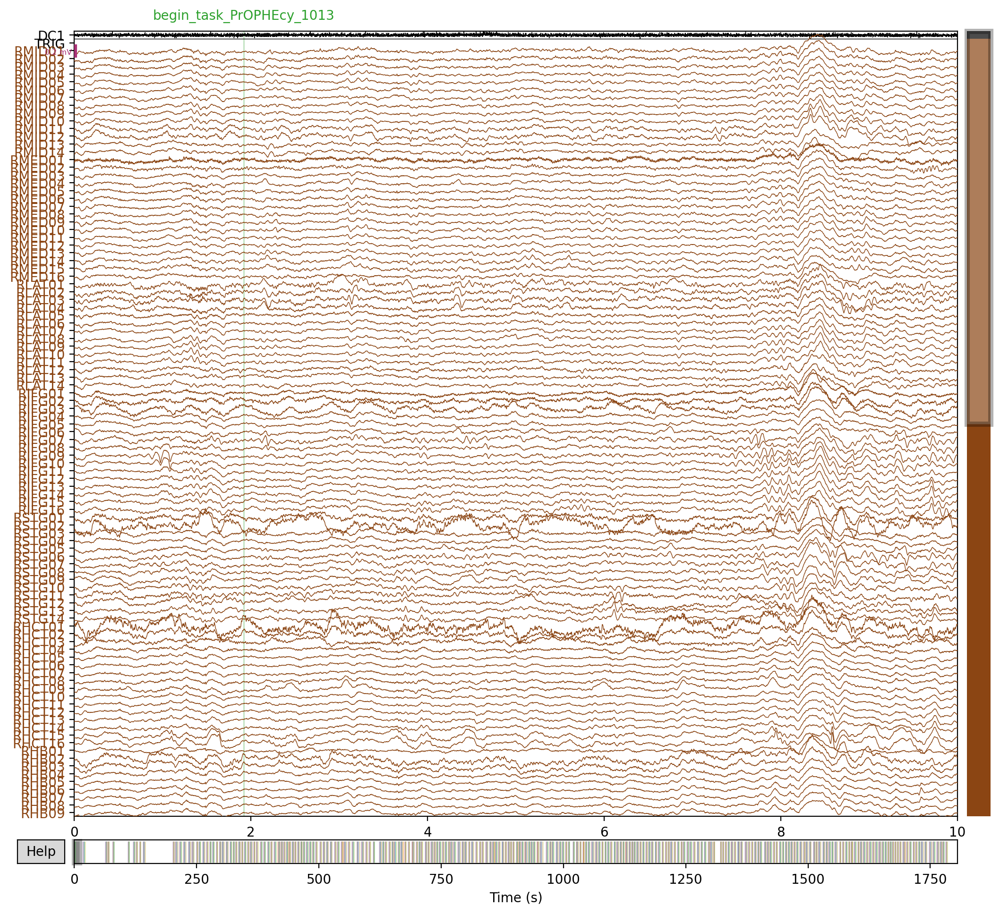

Channels marked as bad:
none


In [5]:
raw.plot(clipping=None, n_channels=int(n_channels/2), scalings=scalings, duration=10) 

Effective window size : 2.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_4609/3521283741.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw.compute_psd(tmin=200, tmax=400, n_fft=int(raw.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()


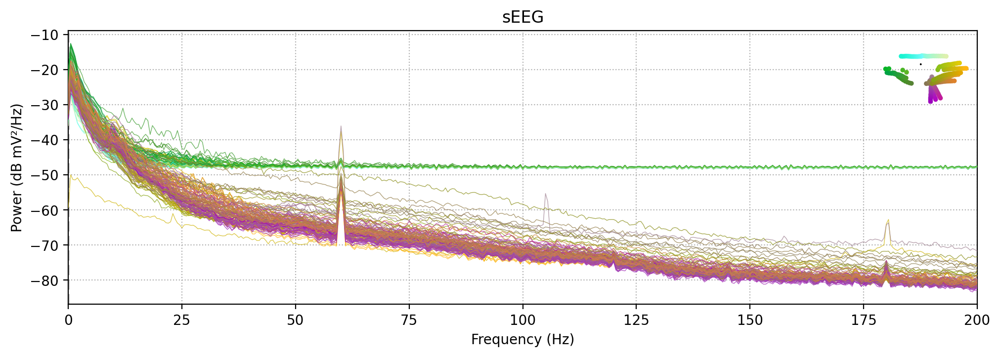

In [6]:
raw.compute_psd(tmin=200, tmax=400, n_fft=int(raw.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()

## 3. Bipolar Rereference

Group channels by sEEG shank (or ECoG grid) and reference to bipolar montage

In [7]:
raw_bip_ref = bipolar_reference(raw, ch_depth)

sEEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=13, n_times=1849088
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.
Added the following bipolar channels:
RMID02-RMID01, RMID03-RMID02, RMID04-RMID03, RMID05-RMID04, RMID06-RMID05, RMID07-RMID06, RMID08-RMID07, RMID09-RMID08, RMID10-RMID09, RMID11-RMID10, RMID12-RMID11, RMID13-RMID12, RMID14-RMID13
['RMED01', 'RMED02', 'RMED03', 'RMED04', 'RMED05', 'RMED06', 'RMED07', 'RMED08', 'RMED09', 'RMED10', 'RMED11', 'RMED12', 'RMED13', 'RMED14', 'RMED15', 'RMED16', 'RLAT01', 'RLAT02', 'RLAT03', 'RLAT04', 'RLAT05', 'RLAT06', 'RLAT07', 'RLAT08', 'RLAT09', 'RLAT10', 'RLAT11', 'RLAT12', 'RLAT13', 'RLAT14', 'RIFG01', 'RIFG02', 'RIFG03', 'RIFG04', 'RIFG05', 'RIFG06', 'RIFG07', 'RIFG08', 'RIFG09', 'RIFG10', 'RIFG11', 'RIFG12', 'RIFG13', 'RIFG14', 'RIFG15', 'RIFG16', 'RSTG01', 'RSTG02', 'RSTG03', 'RSTG04', 'RSTG05', 'RSTG06', 'RSTG07', 'RSTG08', 'RSTG09', 'RSTG10', 'RSTG11', 'RSTG12', 'RSTG13'

sEEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=13, n_times=1849088
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.
Added the following bipolar channels:
RSTG02-RSTG01, RSTG03-RSTG02, RSTG04-RSTG03, RSTG05-RSTG04, RSTG06-RSTG05, RSTG07-RSTG06, RSTG08-RSTG07, RSTG09-RSTG08, RSTG10-RSTG09, RSTG11-RSTG10, RSTG12-RSTG11, RSTG13-RSTG12, RSTG14-RSTG13
['RHCT01', 'RHCT02', 'RHCT03', 'RHCT04', 'RHCT05', 'RHCT06', 'RHCT07', 'RHCT08', 'RHCT09', 'RHCT10', 'RHCT11', 'RHCT12', 'RHCT13', 'RHCT14', 'RHCT15', 'RHCT16', 'RHB01', 'RHB02', 'RHB03', 'RHB04', 'RHB05', 'RHB06', 'RHB07', 'RHB08', 'RHB09', 'RHB10', 'RHB11', 'RHB12', 'RHB13', 'RHB14', 'RHB15', 'RHB16', 'RHH01', 'RHH02', 'RHH03', 'RHH04', 'RHH05', 'RHH06', 'RHH07', 'RHH08', 'RHH09', 'RHH10', 'RHH11', 'RHH12', 'RHH13', 'RHH14', 'RHH15', 'RHH16', 'RA01', 'RA02', 'RA03', 'RA04', 'RA05', 'RA06', 'RA07', 'RA08', 'RA09', 'RA10', 'RA11', 'RA12', 'RA13', 'RA14', 'RA15', 'RA16', 'RC01', 'RC0

sEEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=15, n_times=1849088
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.
Added the following bipolar channels:
RHH02-RHH01, RHH03-RHH02, RHH04-RHH03, RHH05-RHH04, RHH06-RHH05, RHH07-RHH06, RHH08-RHH07, RHH09-RHH08, RHH10-RHH09, RHH11-RHH10, RHH12-RHH11, RHH13-RHH12, RHH14-RHH13, RHH15-RHH14, RHH16-RHH15
['RA01', 'RA02', 'RA03', 'RA04', 'RA05', 'RA06', 'RA07', 'RA08', 'RA09', 'RA10', 'RA11', 'RA12', 'RA13', 'RA14', 'RA15', 'RA16', 'RC01', 'RC02', 'RC03', 'RC04', 'RC05', 'RC06', 'RC07', 'RC08', 'RC09', 'RC10', 'RC11', 'RC12', 'RC13', 'RC14', 'RC15', 'RC16', 'LC01', 'LC02', 'LC03', 'LC04', 'LC05', 'LC06', 'LC07', 'LC08', 'LC09', 'LC10', 'LC11', 'LC12', 'LC13', 'LC14', 'LC15', 'LC16', 'LHT01', 'LHT02', 'LHT03', 'LHT04', 'LHT05', 'LHT06', 'LHT07', 'LHT08', 'LHT09', 'LHT10', 'LHT11', 'LHT12', 'LHH01', 'LHH02', 'LHH03', 'LHH04', 'LHH05', 'LHH06', 'LHH07', 'LHH08', 'LHH09', 'LHH10', 'LHH11

sEEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=15, n_times=1849088
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.
Added the following bipolar channels:
LC02-LC01, LC03-LC02, LC04-LC03, LC05-LC04, LC06-LC05, LC07-LC06, LC08-LC07, LC09-LC08, LC10-LC09, LC11-LC10, LC12-LC11, LC13-LC12, LC14-LC13, LC15-LC14, LC16-LC15
['LHT01', 'LHT02', 'LHT03', 'LHT04', 'LHT05', 'LHT06', 'LHT07', 'LHT08', 'LHT09', 'LHT10', 'LHT11', 'LHT12', 'LHH01', 'LHH02', 'LHH03', 'LHH04', 'LHH05', 'LHH06', 'LHH07', 'LHH08', 'LHH09', 'LHH10', 'LHH11', 'LHH12', 'LHH13', 'LHH14', 'LA01', 'LA04', 'LA05', 'LA07', 'DC1', 'TRIG', 'RMID02-RMID01', 'RMID03-RMID02', 'RMID04-RMID03', 'RMID05-RMID04', 'RMID06-RMID05', 'RMID07-RMID06', 'RMID08-RMID07', 'RMID09-RMID08', 'RMID10-RMID09', 'RMID11-RMID10', 'RMID12-RMID11', 'RMID13-RMID12', 'RMID14-RMID13', 'RMED02-RMED01', 'RMED03-RMED02', 'RMED04-RMED03', 'RMED05-RMED04', 'RMED06-RMED05', 'RMED07-RMED06', 'RMED08-RMED07

sEEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=3, n_times=1849088
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.
Added the following bipolar channels:
LA04-LA01, LA05-LA04, LA07-LA05
['DC1', 'TRIG', 'RMID02-RMID01', 'RMID03-RMID02', 'RMID04-RMID03', 'RMID05-RMID04', 'RMID06-RMID05', 'RMID07-RMID06', 'RMID08-RMID07', 'RMID09-RMID08', 'RMID10-RMID09', 'RMID11-RMID10', 'RMID12-RMID11', 'RMID13-RMID12', 'RMID14-RMID13', 'RMED02-RMED01', 'RMED03-RMED02', 'RMED04-RMED03', 'RMED05-RMED04', 'RMED06-RMED05', 'RMED07-RMED06', 'RMED08-RMED07', 'RMED09-RMED08', 'RMED10-RMED09', 'RMED11-RMED10', 'RMED12-RMED11', 'RMED13-RMED12', 'RMED14-RMED13', 'RMED15-RMED14', 'RMED16-RMED15', 'RLAT02-RLAT01', 'RLAT03-RLAT02', 'RLAT04-RLAT03', 'RLAT05-RLAT04', 'RLAT06-RLAT05', 'RLAT07-RLAT06', 'RLAT08-RLAT07', 'RLAT09-RLAT08', 'RLAT10-RLAT09', 'RLAT11-RLAT10', 'RLAT12-RLAT11', 'RLAT13-RLAT12', 'RLAT14-RLAT13', 'RIFG02-RIFG01', 'RIFG03-RIFG02', 'RIFG

## 4. Filter Line Noise

In [8]:
raw_bip_ref.notch_filter(freqs=np.arange(60, 241, 60)) 

Filtering raw data in 1 contiguous segment
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 6759 samples (6.601 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 186 out of 186 | elapsed:    5.3s finished


Measurement date,"March 18, 2022 13:26:17 GMT"
Experimenter,mne_anonymize
Participant,sub-1013
Digitized points,200 points
Good channels,"2 Stimulus, 186 sEEG"
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1024.00 Hz
Highpass,0.00 Hz
Lowpass,512.00 Hz


Effective window size : 2.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_4609/2822086040.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_bip_ref.compute_psd(tmin=200, tmax=400, n_fft=int(raw_bip_ref.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()


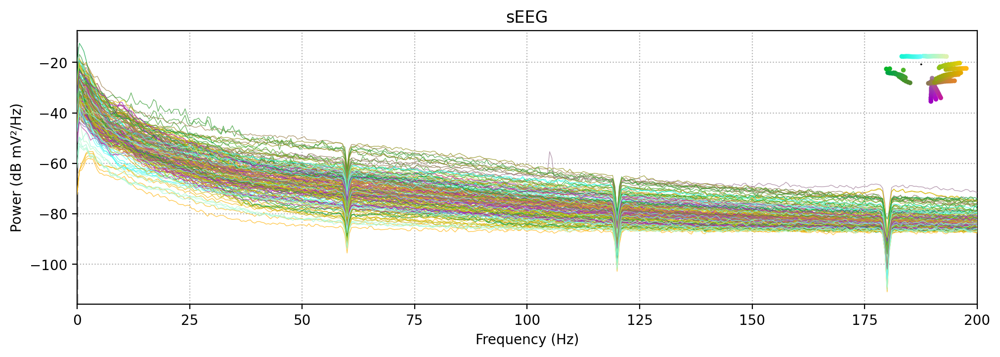

In [9]:
raw_bip_ref.compute_psd(tmin=200, tmax=400, n_fft=int(raw_bip_ref.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()

## 5. Inspect and Remove Bad Channels

In [10]:
raw_bip_ref.info['bads'] = info['ch_drop_name'].tolist()

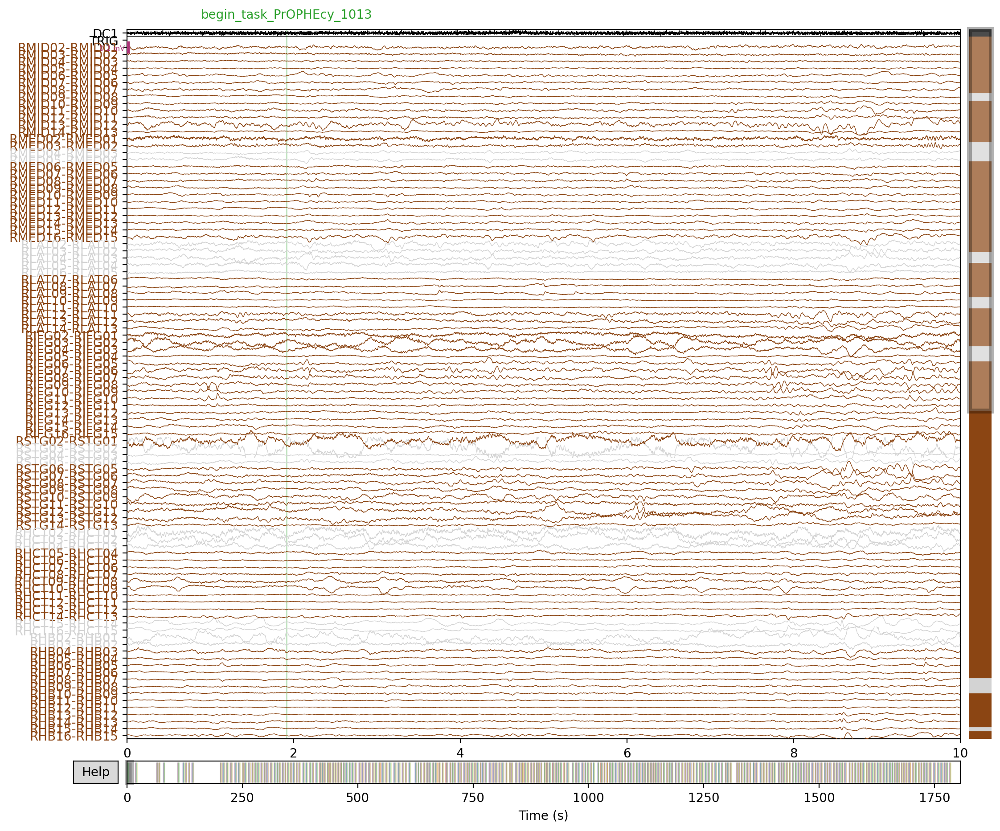

Channels marked as bad:
['LHH02-LHH01', 'LHH03-LHH02', 'LHH04-LHH03', 'LHH05-LHH04', 'LA04-LA01', 'RHCT04-RHCT03', 'RHCT03-RHCT02', 'RHCT02-RHCT01', 'RSTG03-RSTG02', 'RSTG04-RSTG03', 'RSTG05-RSTG04', 'RLAT02-RLAT01', 'RLAT03-RLAT02', 'RLAT04-RLAT03', 'RLAT05-RLAT04', 'RLAT06-RLAT05', 'RMED04-RMED03', 'RMED05-RMED04', 'RHCT16-RHCT15', 'RHCT15-RHCT14', 'RHB02-RHB01', 'RHB03-RHB02']


In [11]:
raw_bip_ref.plot(n_channels=int(n_channels/2), duration=10, scalings=scalings) 

Effective window size : 2.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_4609/2822086040.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_bip_ref.compute_psd(tmin=200, tmax=400, n_fft=int(raw_bip_ref.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()


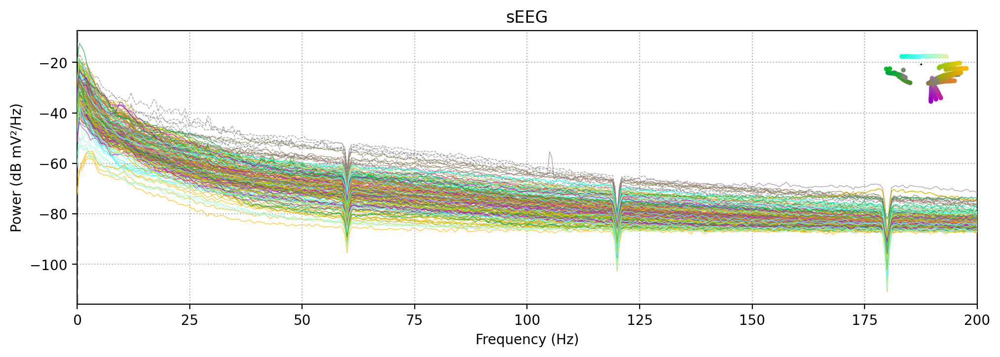

In [12]:
raw_bip_ref.compute_psd(tmin=200, tmax=400, n_fft=int(raw_bip_ref.info['sfreq']*2), n_overlap=int(raw.info['sfreq']/2), fmax=200.).plot()

## 6. Save Continuous Data

In [13]:
raw_bip_ref.save('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_BIPreref_ieeg.fif',
               overwrite=True)

Overwriting existing file.
Writing /Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/1013/1013_BIPreref_ieeg.fif
Closing /Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/1013/1013_BIPreref_ieeg.fif
[done]


## 7. Epoch Data

In [14]:
events, event_id = mne.events_from_annotations(raw_bip_ref)

epochs = mne.Epochs(raw_bip_ref, events, event_id={'first_tone': event_id['first_tone']},
                     tmin=-0.8, tmax=5.0, picks=['seeg', 'stim'], preload=True)

epochs = add_metadata(subj, epochs)

Used Annotations descriptions: ['Patient Event', 'XLEvent', 'begin_task_PrOPHEcy_1013', 'begin_trial', 'first_tone', 'fourth_tone', 'second_tone', 'target_tone', 'third_tone']
Not setting metadata
249 matching events found
Setting baseline interval to [-0.7998046875, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 249 events and 5940 original time points ...
0 bad epochs dropped
Adding metadata with 9 columns


## 8. Reject Bad Epochs

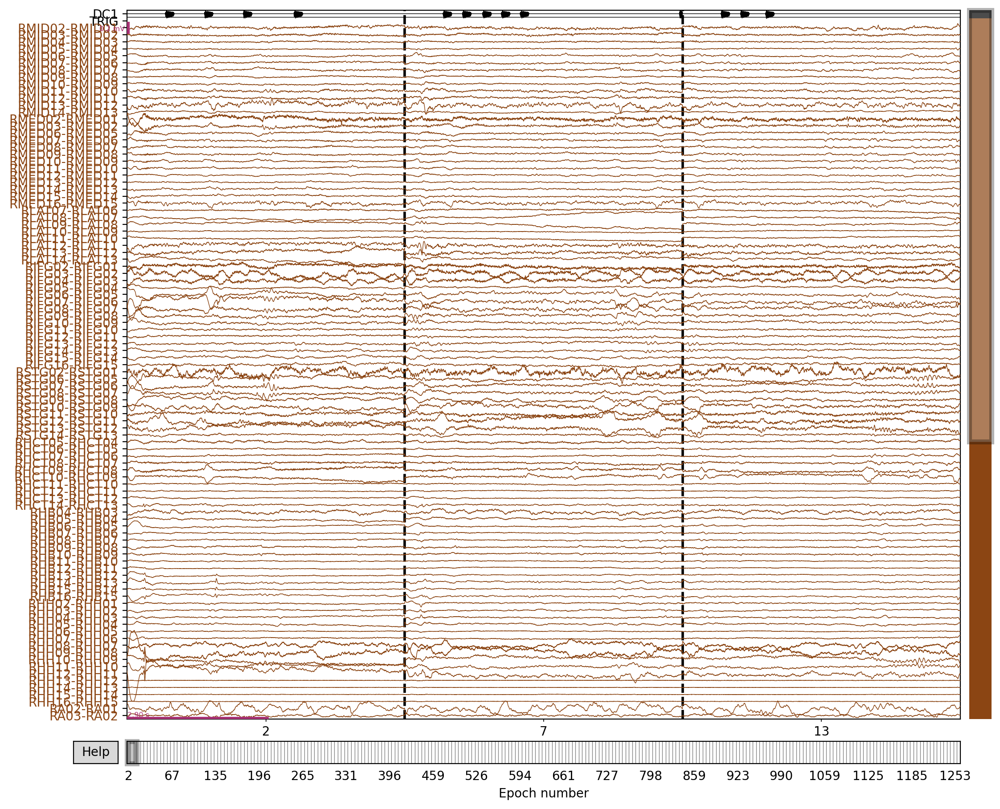

Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
['LHH02-LHH01', 'LHH03-LHH02', 'LHH04-LHH03', 'LHH05-LHH04', 'LA04-LA01', 'RHCT04-RHCT03', 'RHCT03-RHCT02', 'RHCT02-RHCT01', 'RSTG03-RSTG02', 'RSTG04-RSTG03', 'RSTG05-RSTG04', 'RLAT02-RLAT01', 'RLAT03-RLAT02', 'RLAT04-RLAT03', 'RLAT05-RLAT04', 'RLAT06-RLAT05', 'RMED04-RMED03', 'RMED05-RMED04', 'RHCT16-RHCT15', 'RHCT15-RHCT14', 'RHB02-RHB01', 'RHB03-RHB02']


In [15]:
epochs.plot(picks=['seeg', 'stim'], scalings=scalings, n_epochs=3, n_channels=int(n_channels/2))

In [16]:
epochs.drop(indices=info['epo_drop_ind'])

Dropped 70 epochs: 8, 12, 14, 18, 21, 23, 30, 33, 38, 43, 44, 48, 49, 50, 51, 59, 60, 65, 70, 79, 98, 99, 100, 101, 103, 104, 110, 113, 115, 119, 121, 124, 132, 136, 143, 146, 147, 150, 151, 160, 165, 170, 172, 173, 176, 177, 178, 180, 183, 190, 191, 199, 201, 202, 203, 206, 213, 214, 216, 217, 222, 227, 232, 235, 236, 238, 239, 243, 244, 246


Number of events,179
Events,first_tone: 179
Time range,-0.800 – 5.000 s
Baseline,-0.800 – 0.000 s


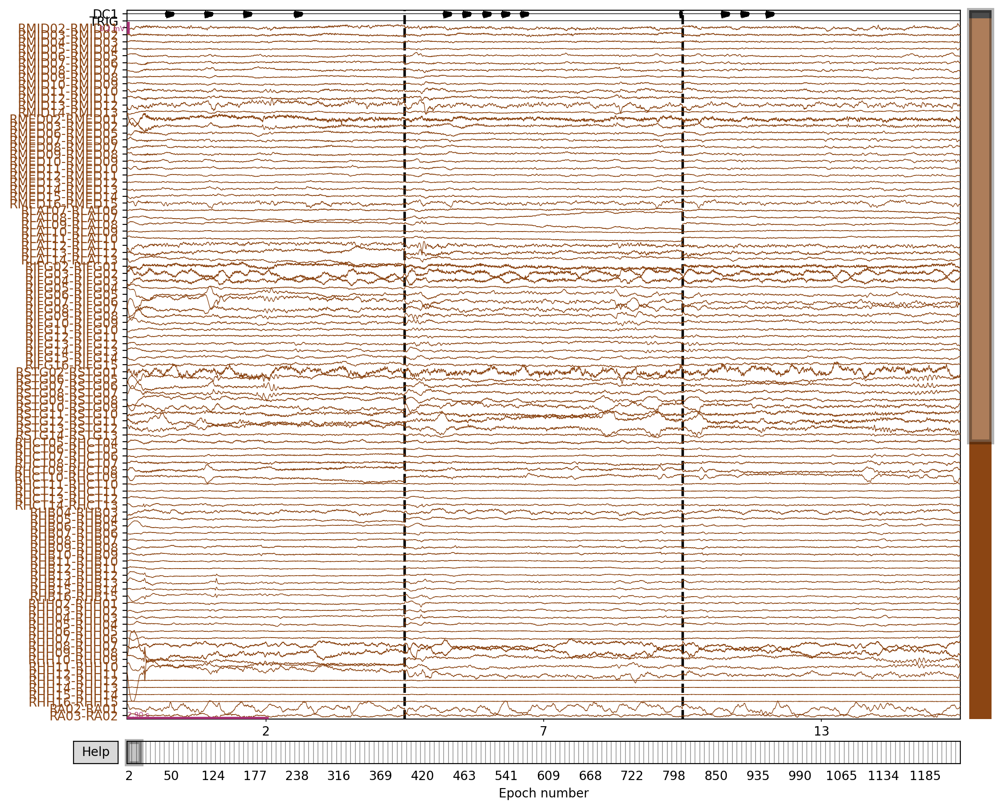

Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
['LHH02-LHH01', 'LHH03-LHH02', 'LHH04-LHH03', 'LHH05-LHH04', 'LA04-LA01', 'RHCT04-RHCT03', 'RHCT03-RHCT02', 'RHCT02-RHCT01', 'RSTG03-RSTG02', 'RSTG04-RSTG03', 'RSTG05-RSTG04', 'RLAT02-RLAT01', 'RLAT03-RLAT02', 'RLAT04-RLAT03', 'RLAT05-RLAT04', 'RLAT06-RLAT05', 'RMED04-RMED03', 'RMED05-RMED04', 'RHCT16-RHCT15', 'RHCT15-RHCT14', 'RHB02-RHB01', 'RHB03-RHB02']


In [22]:
epochs.plot(picks=['seeg', 'stim'], scalings=scalings, n_epochs=3, n_channels=int(n_channels/2))

    Using multitaper spectrum estimation with 7 DPSS windows
Plotting power spectral density (dB=True).
Averaging across epochs...


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_4609/3768068452.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  epochs.compute_psd(fmax=200.).plot()


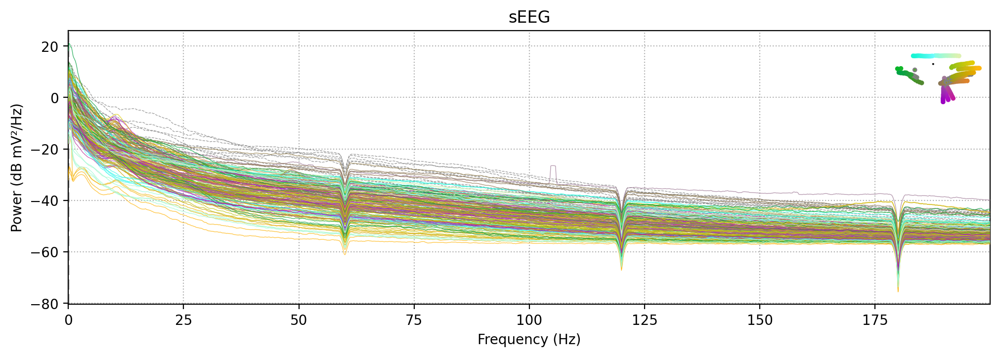

In [18]:
epochs.compute_psd(fmax=200.).plot()

## 9. Save Epoched Data

In [19]:
epochs.save('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_BIP_epo.fif',
            overwrite=True)

Overwriting existing file.
Overwriting existing file.


# Temporary: 

Make .npz files containing information for preprocessing. This includes:
    
- 'ch_type' : dictionary  
    dictionary identifying all channels in data as seeg, misc, ecg, eeg, or stim channels types, keys are channel type and values are channel names of that type
- 'ch_depth' : list  
    list of lists grouping seeg channels by depth probe (for rereferencing)
- 'ch_trig' : list  
    list of stimulus channels
- 'ch_drop_name' : list  
    list of channels to drop from data
- 'ch_drop_reason' : list  
    list of reasons channels were dropped (interictal, flat, noisy)
- 'epo_drop_ind' : list  
    list of indices of epochs marked as bad
- 'epo_drop_reason' : list  
    list of reasons epochs were dropped (interictal, flat, jump)

In [4]:
raw_bip_temp = mne.io.read_raw('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_BIPreref_ieeg.fif')


Opening raw data file /Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/1013/1013_BIPreref_ieeg.fif...
    Range : 0 ... 1849087 =      0.000 ...  1805.749 secs
Ready.


Using matplotlib as 2D backend.


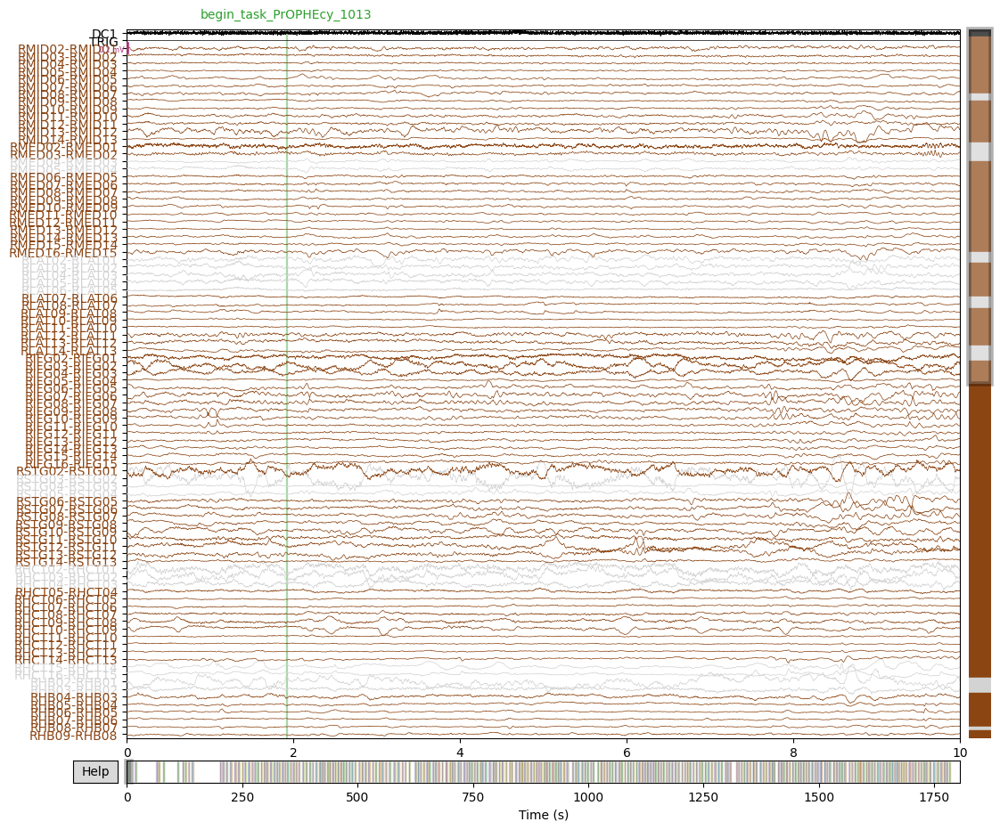

Channels marked as bad:
['LHH02-LHH01', 'LHH03-LHH02', 'LHH04-LHH03', 'LHH05-LHH04', 'LA04-LA01', 'RHCT04-RHCT03', 'RHCT03-RHCT02', 'RHCT02-RHCT01', 'RSTG03-RSTG02', 'RSTG04-RSTG03', 'RSTG05-RSTG04', 'RLAT02-RLAT01', 'RLAT03-RLAT02', 'RLAT04-RLAT03', 'RLAT05-RLAT04', 'RLAT06-RLAT05', 'RMED04-RMED03', 'RMED05-RMED04', 'RHCT16-RHCT15', 'RHCT15-RHCT14', 'RHB02-RHB01', 'RHB03-RHB02']


In [5]:
scalings = {'seeg' : 100e-6}
n_channels = len(raw_bip_temp.info['ch_names'])
raw_bip_temp.plot(clipping=None, n_channels=int(n_channels/2), scalings=scalings, duration=10)

In [12]:
shanks = np.load('/Users/sydneysmith/Projects/piepy/tutorials/shank_info/shank_list_'+subj+'.npy',
                 allow_pickle=True)

In [15]:
info['ch_drop_reason'].tolist()

['interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal']

In [13]:
shanks.tolist()

[['RMID01',
  'RMID02',
  'RMID03',
  'RMID04',
  'RMID05',
  'RMID06',
  'RMID07',
  'RMID08',
  'RMID09',
  'RMID10',
  'RMID11',
  'RMID12',
  'RMID13',
  'RMID14'],
 ['RMED01',
  'RMED02',
  'RMED03',
  'RMED04',
  'RMED05',
  'RMED06',
  'RMED07',
  'RMED08',
  'RMED09',
  'RMED10',
  'RMED11',
  'RMED12',
  'RMED13',
  'RMED14',
  'RMED15',
  'RMED16'],
 ['RLAT01',
  'RLAT02',
  'RLAT03',
  'RLAT04',
  'RLAT05',
  'RLAT06',
  'RLAT07',
  'RLAT08',
  'RLAT09',
  'RLAT10',
  'RLAT11',
  'RLAT12',
  'RLAT13',
  'RLAT14'],
 ['RIFG01',
  'RIFG02',
  'RIFG03',
  'RIFG04',
  'RIFG05',
  'RIFG06',
  'RIFG07',
  'RIFG08',
  'RIFG09',
  'RIFG10',
  'RIFG11',
  'RIFG12',
  'RIFG13',
  'RIFG14',
  'RIFG15',
  'RIFG16'],
 ['RSTG01',
  'RSTG02',
  'RSTG03',
  'RSTG04',
  'RSTG05',
  'RSTG06',
  'RSTG07',
  'RSTG08',
  'RSTG09',
  'RSTG10',
  'RSTG11',
  'RSTG12',
  'RSTG13',
  'RSTG14'],
 ['RHCT01',
  'RHCT02',
  'RHCT03',
  'RHCT04',
  'RHCT05',
  'RHCT06',
  'RHCT07',
  'RHCT08',
  'RHCT09',

In [24]:
# 1013

scalings = {'seeg' : 100e-6}

ch_type = {'seeg': ['RMID01',
  'RMID02',
  'RMID03',
  'RMID04',
  'RMID05',
  'RMID06',
  'RMID07',
  'RMID08',
  'RMID09',
  'RMID10',
  'RMID11',
  'RMID12',
  'RMID13',
  'RMID14',
  'RMED01',
  'RMED02',
  'RMED03',
  'RMED04',
  'RMED05',
  'RMED06',
  'RMED07',
  'RMED08',
  'RMED09',
  'RMED10',
  'RMED11',
  'RMED12',
  'RMED13',
  'RMED14',
  'RMED15',
  'RMED16',
  'RLAT01',
  'RLAT02',
  'RLAT03',
  'RLAT04',
  'RLAT05',
  'RLAT06',
  'RLAT07',
  'RLAT08',
  'RLAT09',
  'RLAT10',
  'RLAT11',
  'RLAT12',
  'RLAT13',
  'RLAT14',
  'RIFG01',
  'RIFG02',
  'RIFG03',
  'RIFG04',
  'RIFG05',
  'RIFG06',
  'RIFG07',
  'RIFG08',
  'RIFG09',
  'RIFG10',
  'RIFG11',
  'RIFG12',
  'RIFG13',
  'RIFG14',
  'RIFG15',
  'RIFG16',
  'RSTG01',
  'RSTG02',
  'RSTG03',
  'RSTG04',
  'RSTG05',
  'RSTG06',
  'RSTG07',
  'RSTG08',
  'RSTG09',
  'RSTG10',
  'RSTG11',
  'RSTG12',
  'RSTG13',
  'RSTG14',
  'RHCT01',
  'RHCT02',
  'RHCT03',
  'RHCT04',
  'RHCT05',
  'RHCT06',
  'RHCT07',
  'RHCT08',
  'RHCT09',
  'RHCT10',
  'RHCT11',
  'RHCT12',
  'RHCT13',
  'RHCT14',
  'RHCT15',
  'RHCT16',
  'RHB01',
  'RHB02',
  'RHB03',
  'RHB04',
  'RHB05',
  'RHB06',
  'RHB07',
  'RHB08',
  'RHB09',
  'RHB10',
  'RHB11',
  'RHB12',
  'RHB13',
  'RHB14',
  'RHB15',
  'RHB16',
  'RHH01',
  'RHH02',
  'RHH03',
  'RHH04',
  'RHH05',
  'RHH06',
  'RHH07',
  'RHH08',
  'RHH09',
  'RHH10',
  'RHH11',
  'RHH12',
  'RHH13',
  'RHH14',
  'RHH15',
  'RHH16',
  'RA01',
  'RA02',
  'RA03',
  'RA04',
  'RA05',
  'RA06',
  'RA07',
  'RA08',
  'RA09',
  'RA10',
  'RA11',
  'RA12',
  'RA13',
  'RA14',
  'RA15',
  'RA16',
  'RC01',
  'RC02',
  'RC03',
  'RC04',
  'RC05',
  'RC06',
  'RC07',
  'RC08',
  'RC09',
  'RC10',
  'RC11',
  'RC12',
  'RC13',
  'RC14',
  'RC15',
  'RC16',
  'LC01',
  'LC02',
  'LC03',
  'LC04',
  'LC05',
  'LC06',
  'LC07',
  'LC08',
  'LC09',
  'LC10',
  'LC11',
  'LC12',
  'LC13',
  'LC14',
  'LC15',
  'LC16',
  'LHT01',
  'LHT02',
  'LHT03',
  'LHT04',
  'LHT05',
  'LHT06',
  'LHT07',
  'LHT08',
  'LHT09',
  'LHT10',
  'LHT11',
  'LHT12',
  'LHH01',
  'LHH02',
  'LHH03',
  'LHH04',
  'LHH05',
  'LHH06',
  'LHH07',
  'LHH08',
  'LHH09',
  'LHH10',
  'LHH11',
  'LHH12',
  'LHH13',
  'LHH14',
  'LA01',
  'LA02',
  'LA03',
  'LA04',
  'LA05',
  'LA06',
  'LA07',
  'LA08',
  'LA09',
  'LA10',
  'LA11',
  'LA12',
  'LA13',
  'LA14',
  'LA15',
  'LA16'],
 'ecog': [],
 'misc': ['Trigger Event'],
 'ecg': ['EKG1', 'EKG2'],
 'eeg': [],
 'stim': ['DC1', 'TRIG']}

ch_depth = np.array([['RMID01',
  'RMID02',
  'RMID03',
  'RMID04',
  'RMID05',
  'RMID06',
  'RMID07',
  'RMID08',
  'RMID09',
  'RMID10',
  'RMID11',
  'RMID12',
  'RMID13',
  'RMID14'],
 ['RMED01',
  'RMED02',
  'RMED03',
  'RMED04',
  'RMED05',
  'RMED06',
  'RMED07',
  'RMED08',
  'RMED09',
  'RMED10',
  'RMED11',
  'RMED12',
  'RMED13',
  'RMED14',
  'RMED15',
  'RMED16'],
 ['RLAT01',
  'RLAT02',
  'RLAT03',
  'RLAT04',
  'RLAT05',
  'RLAT06',
  'RLAT07',
  'RLAT08',
  'RLAT09',
  'RLAT10',
  'RLAT11',
  'RLAT12',
  'RLAT13',
  'RLAT14'],
 ['RIFG01',
  'RIFG02',
  'RIFG03',
  'RIFG04',
  'RIFG05',
  'RIFG06',
  'RIFG07',
  'RIFG08',
  'RIFG09',
  'RIFG10',
  'RIFG11',
  'RIFG12',
  'RIFG13',
  'RIFG14',
  'RIFG15',
  'RIFG16'],
 ['RSTG01',
  'RSTG02',
  'RSTG03',
  'RSTG04',
  'RSTG05',
  'RSTG06',
  'RSTG07',
  'RSTG08',
  'RSTG09',
  'RSTG10',
  'RSTG11',
  'RSTG12',
  'RSTG13',
  'RSTG14'],
 ['RHCT01',
  'RHCT02',
  'RHCT03',
  'RHCT04',
  'RHCT05',
  'RHCT06',
  'RHCT07',
  'RHCT08',
  'RHCT09',
  'RHCT10',
  'RHCT11',
  'RHCT12',
  'RHCT13',
  'RHCT14',
  'RHCT15',
  'RHCT16'],
 ['RHB01',
  'RHB02',
  'RHB03',
  'RHB04',
  'RHB05',
  'RHB06',
  'RHB07',
  'RHB08',
  'RHB09',
  'RHB10',
  'RHB11',
  'RHB12',
  'RHB13',
  'RHB14',
  'RHB15',
  'RHB16'],
 ['RHH01',
  'RHH02',
  'RHH03',
  'RHH04',
  'RHH05',
  'RHH06',
  'RHH07',
  'RHH08',
  'RHH09',
  'RHH10',
  'RHH11',
  'RHH12',
  'RHH13',
  'RHH14',
  'RHH15',
  'RHH16'],
 ['RA01',
  'RA02',
  'RA03',
  'RA04',
  'RA05',
  'RA06',
  'RA07',
  'RA08',
  'RA09',
  'RA10',
  'RA11',
  'RA12',
  'RA13',
  'RA14',
  'RA15',
  'RA16'],
 ['RC01',
  'RC02',
  'RC03',
  'RC04',
  'RC05',
  'RC06',
  'RC07',
  'RC08',
  'RC09',
  'RC10',
  'RC11',
  'RC12',
  'RC13',
  'RC14',
  'RC15',
  'RC16'],
 ['LC01',
  'LC02',
  'LC03',
  'LC04',
  'LC05',
  'LC06',
  'LC07',
  'LC08',
  'LC09',
  'LC10',
  'LC11',
  'LC12',
  'LC13',
  'LC14',
  'LC15',
  'LC16'],
 ['LHT01',
  'LHT02',
  'LHT03',
  'LHT04',
  'LHT05',
  'LHT06',
  'LHT07',
  'LHT08',
  'LHT09',
  'LHT10',
  'LHT11',
  'LHT12'],
 ['LHH01',
  'LHH02',
  'LHH03',
  'LHH04',
  'LHH05',
  'LHH06',
  'LHH07',
  'LHH08',
  'LHH09',
  'LHH10',
  'LHH11',
  'LHH12',
  'LHH13',
  'LHH14'],
 ['LA01', 'LA04', 'LA05', 'LA07']], dtype=object)
                     

ch_trig = ['DC1', 'TRIG']

ch_drop_name = ['LHH02-LHH01',
 'LHH03-LHH02',
 'LHH04-LHH03',
 'LHH05-LHH04',
 'LA04-LA01',
 'RHCT04-RHCT03',
 'RHCT03-RHCT02',
 'RHCT02-RHCT01',
 'RSTG03-RSTG02',
 'RSTG04-RSTG03',
 'RSTG05-RSTG04',
 'RLAT02-RLAT01',
 'RLAT03-RLAT02',
 'RLAT04-RLAT03',
 'RLAT05-RLAT04',
 'RLAT06-RLAT05',
 'RMED04-RMED03',
 'RMED05-RMED04',
 'RHCT16-RHCT15',
 'RHCT15-RHCT14',
 'RHB02-RHB01',
 'RHB03-RHB02']

ch_drop_reason = ['interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal',
 'interictal'] 

epo_drop_ind = [8, 12, 14, 18, 21, 23, 30, 33,
                38, 43, 44, 48, 49, 50, 51, 59,
                60, 65, 70, 79, 98, 99, 100,
                101, 103, 104, 110, 113, 115,
                119, 121, 124, 132, 136, 143,
                146, 147, 150, 151, 160, 165,
                170, 172, 173, 176, 177, 178,
                180, 183, 190, 191, 199, 201,
                202, 203, 206, 213, 214, 216,
                217, 222, 227, 232, 235, 236,
                238, 239, 243, 244, 246]

epo_drop_reason = np.tile('interictal', len(epo_drop_ind)).tolist()

In [26]:
len(epo_drop_ind) == len(epo_drop_reason)

True

In [27]:
len(ch_drop_name) == len(ch_drop_reason)

True

In [28]:
np.savez('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_preprocess_info.npz', 
         scalings=scalings,
         ch_type=ch_type,
         ch_depth=ch_depth,
         ch_trig=ch_trig,
         ch_drop_name=ch_drop_name,
         ch_drop_reason=ch_drop_reason,
         epo_drop_ind=epo_drop_ind,
         epo_drop_reason=epo_drop_reason)

In [30]:
# info = np.load('/Volumes/bvoytek/Smith/UCSD_iEEG/projects/PrOPHECy/'+subj+'/'+subj+'_preprocess_info.npz',
#                allow_pickle=True)

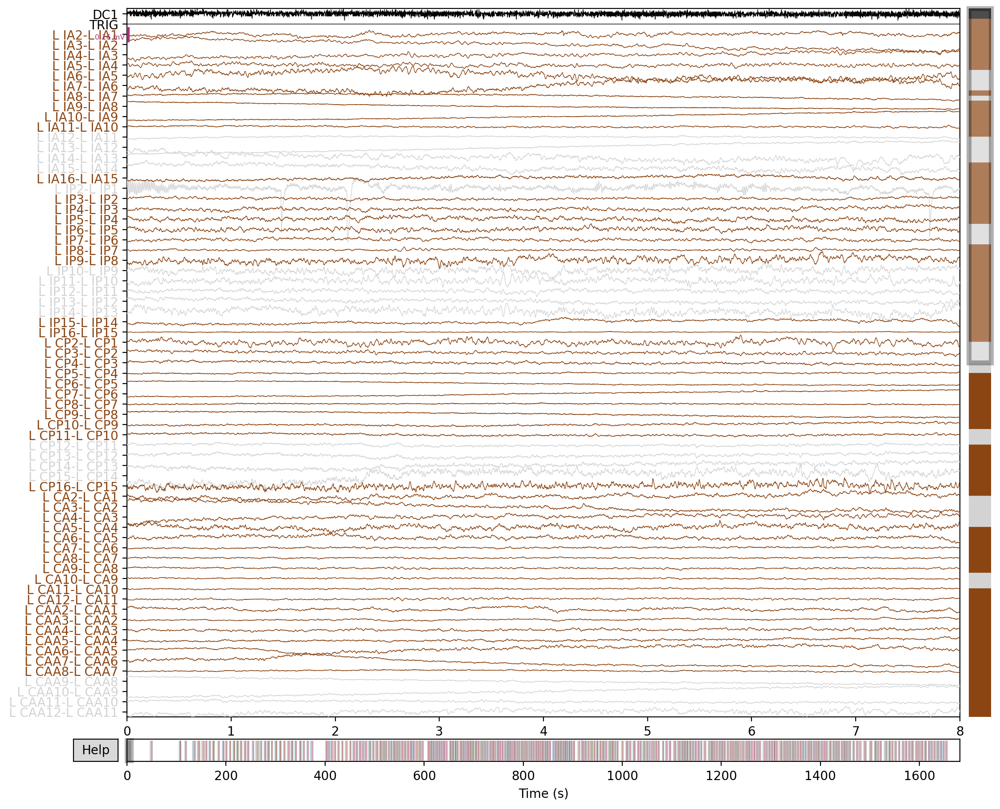

Channels marked as bad:
['L IA13-L IA12', 'L IA14-L IA13', 'L IA15-L IA14', 'L IA12-L IA11', 'L IP10-L IP9', 'L IP11-L IP10', 'L IP12-L IP11', 'L IP13-L IP12', 'L IP14-L IP13', 'L CAA10-L CAA9', 'L CAA11-L CAA10', 'L CAA12-L CAA11', 'L CAA9-L CAA8', 'L CAA13-L CAA12', 'L CAA14-L CAA13', 'L CP12-L CP11', 'L CP13-L CP12', 'L CP14-L CP13', 'L CP15-L CP14', 'L HT2-L HT1', 'L HT3-L HT2', 'L HT4-L HT3', 'L HH2-L HH1', 'L HH3-L HH2', 'L HH4-L HH3', 'L HH5-L HH4', 'L HH6-L HH5', 'L HH7-L HH6', 'L A2-L A1', 'L A3-L A2', 'L A4-L A3', 'L IP2-L IP1', 'L IP16-L IP15', 'L FO12-L FO11', 'L A16-L A15']


In [15]:
scalings = {'seeg' : 80e-6}
n_channels = len(raw_bip_temp.info['ch_names'])

raw_bip_temp.plot(clipping=None, n_channels=int(n_channels/2), scalings=scalings, duration=8) 

Effective window size : 4.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_46178/1619463661.py:3: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_bip_temp.compute_psd(n_fft=int(sfreq*4), n_overlap=int(sfreq*2), fmax=200.).plot()


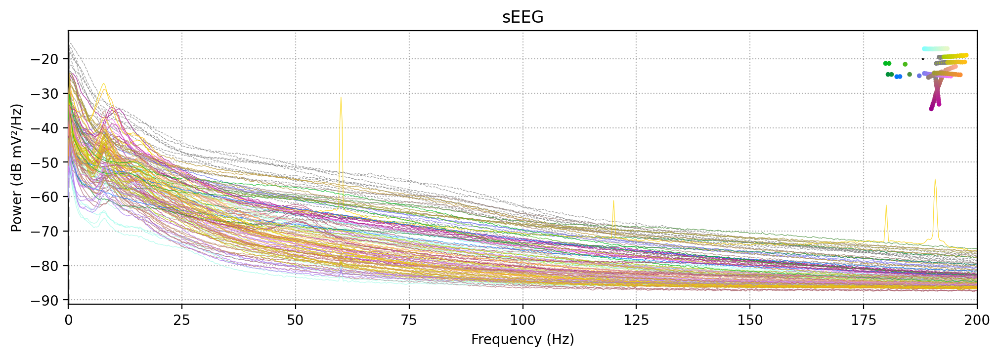

In [10]:
sfreq=raw_bip_temp.info['sfreq']

raw_bip_temp.compute_psd(n_fft=int(sfreq*4), n_overlap=int(sfreq*2), fmax=200.).plot()

In [16]:
flats = ['L IP16-L IP15', 'L FO12-L FO11', 'L A16-L A15']

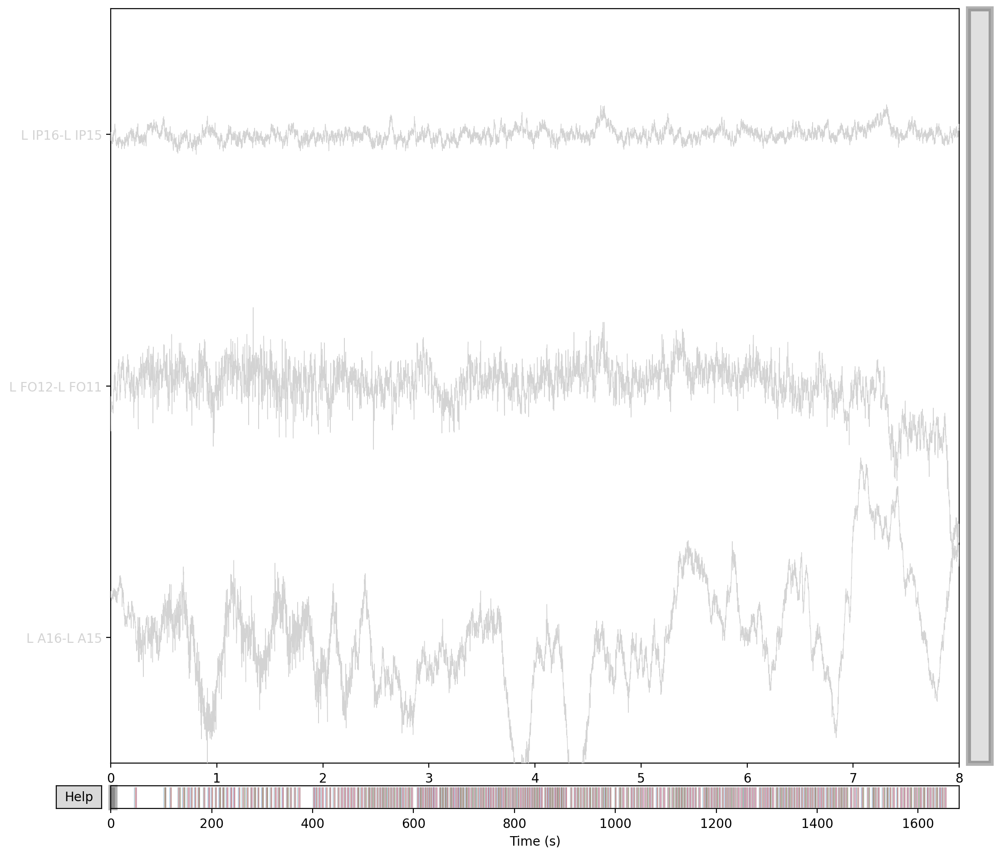

In [17]:
scalings = {'seeg' : 50e-6}
n_channels = len(raw_bip_temp.info['ch_names'])

raw_bip_temp.plot(picks=flats, clipping=None, n_channels=int(n_channels/2), scalings=scalings, duration=8) 

Effective window size : 2.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_45888/2976295216.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_bip_temp.compute_psd(picks=flats, tmin=100, tmax=200, fmax=200.).plot()


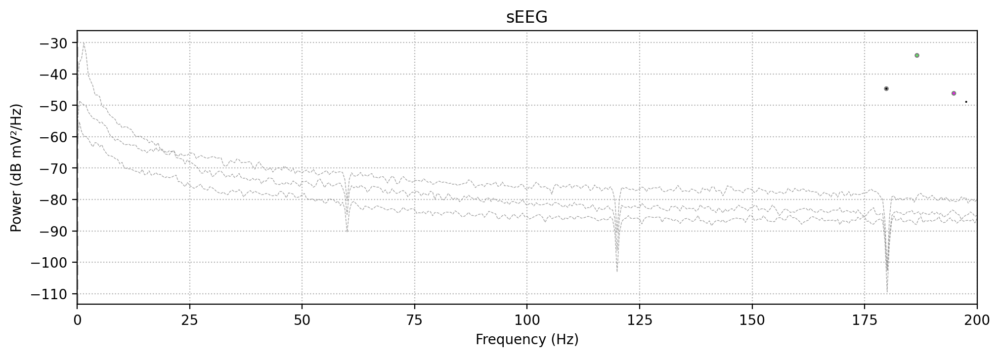

Channels marked as bad:
['L IA13-L IA12', 'L IA14-L IA13', 'L IA15-L IA14', 'L IA12-L IA11', 'L IP10-L IP9', 'L IP11-L IP10', 'L IP12-L IP11', 'L IP13-L IP12', 'L IP14-L IP13', 'L CAA10-L CAA9', 'L CAA11-L CAA10', 'L CAA12-L CAA11', 'L CAA9-L CAA8', 'L CAA13-L CAA12', 'L CAA14-L CAA13', 'L CP12-L CP11', 'L CP13-L CP12', 'L CP14-L CP13', 'L CP15-L CP14', 'L HT2-L HT1', 'L HT3-L HT2', 'L HT4-L HT3', 'L HH2-L HH1', 'L HH3-L HH2', 'L HH4-L HH3', 'L HH5-L HH4', 'L HH6-L HH5', 'L HH7-L HH6', 'L A2-L A1', 'L A3-L A2', 'L A4-L A3', 'L IP2-L IP1', 'L IP16-L IP15', 'L FO12-L FO11', 'L A16-L A15']


In [18]:
raw_bip_temp.compute_psd(picks=flats, tmin=100, tmax=200, fmax=200.).plot()

In [11]:
raw_bip_temp.load_data()
raw_bip_temp.notch_filter(freqs=np.arange(60, 241, 60))

Reading 0 ... 3116031  =      0.000 ...  3042.999 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 6759 samples (6.601 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 126 out of 126 | elapsed:    7.4s finished


Measurement date,"February 16, 2022 13:38:20 GMT"
Experimenter,mne_anonymize
Participant,sub-1012
Digitized points,137 points
Good channels,"1 ECG, 2 Stimulus, 114 sEEG"
Bad channels,"RHH02-RHH01, RHH03-RHH02, RHH04-RHH03, RHH05-RHH04, RHH06-RHH05, RHH07-RHH06, RAMY02-RAMY01, RAMY03-RAMY02, RAMY04-RAMY03, OCHCT03-OCHCT02, OCHCT02-OCHCT01, OCHCT04-OCHCT03"
EOG channels,Not available
ECG channels,EKG
Sampling frequency,1024.00 Hz
Highpass,0.00 Hz
Lowpass,512.00 Hz


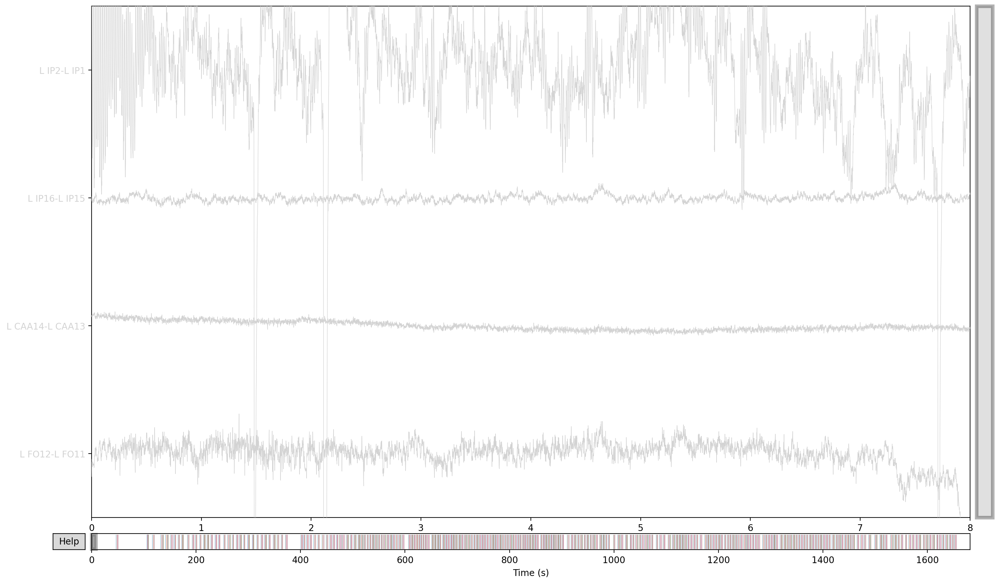

In [29]:
scalings = {'seeg' : 50e-6}
n_channels = len(raw_bip_temp.info['ch_names'])

raw_bip_temp.plot(picks=flats, clipping=None, n_channels=int(n_channels/2), scalings=scalings, duration=8) 

Effective window size : 2.000 (s)
Plotting power spectral density (dB=True).


/var/folders/96/g2_ml18s7v1cqm0wh8_8n5bh0000gn/T/ipykernel_46178/4265595097.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_bip_temp.compute_psd(n_overlap=500, tmin=100, tmax=200, fmax=200.).plot()


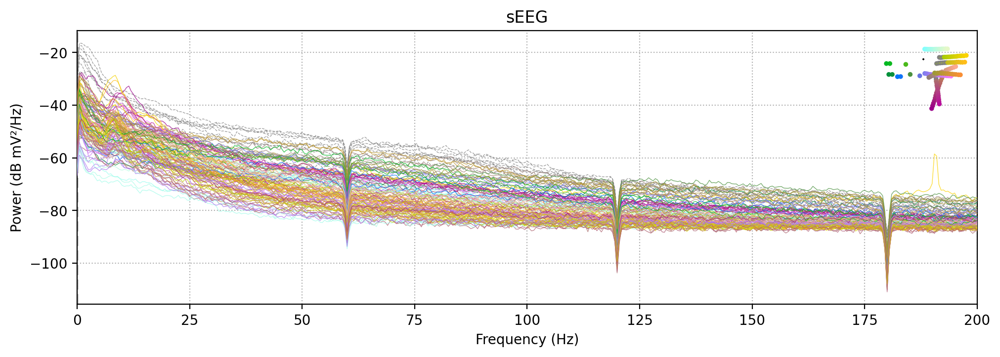

In [12]:
raw_bip_temp.compute_psd(n_overlap=500, tmin=100, tmax=200, fmax=200.).plot()

In [17]:
# label bads from info file
raw_bip_temp.info['bads'] = info['ch_drop_name'].tolist()

In [19]:
events, event_id = mne.events_from_annotations(raw_bip_temp)

epochs = mne.Epochs(raw_bip_temp, events, event_id={'first_tone': event_id['first_tone']},
                     tmin=-0.8, tmax=5.0, picks=['seeg', 'stim'], preload=True)

epochs = add_metadata(subj, epochs)

Used Annotations descriptions: ['Patient Event', 'XLEvent', 'begin_task_PrOPHEcy_1013', 'begin_trial', 'first_tone', 'fourth_tone', 'second_tone', 'target_tone', 'third_tone']
Not setting metadata
249 matching events found
Setting baseline interval to [-0.7998046875, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 249 events and 5940 original time points ...
0 bad epochs dropped
Adding metadata with 9 columns


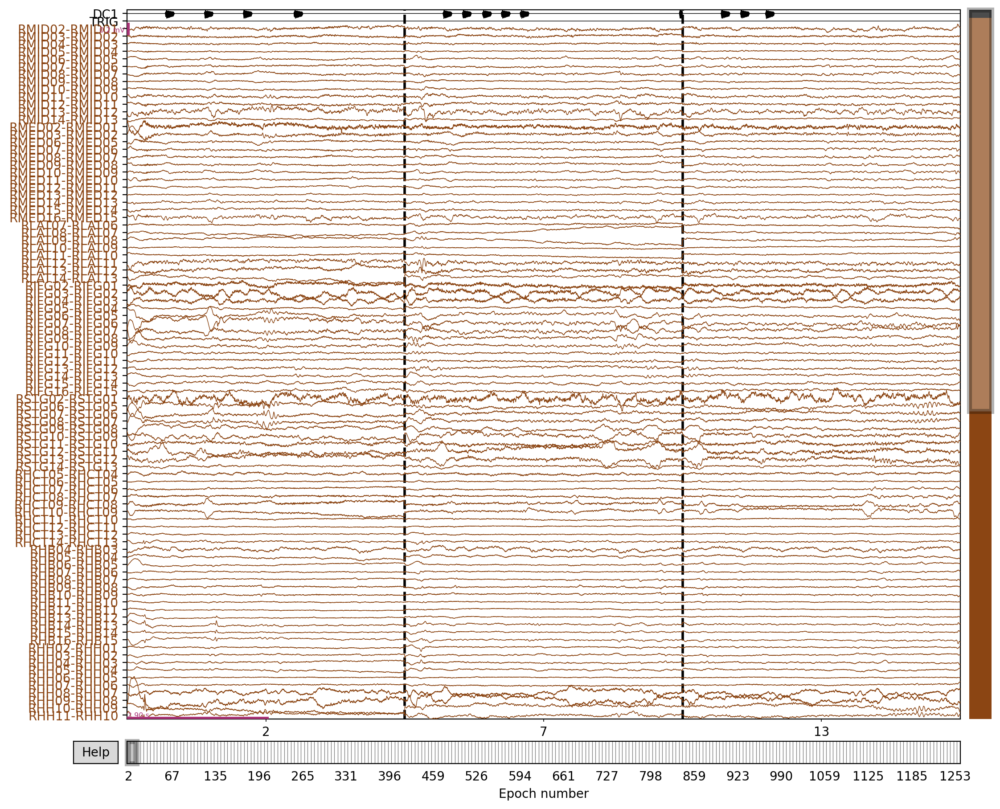

Dropped 70 epochs: 8, 12, 14, 18, 21, 23, 30, 33, 38, 43, 44, 48, 49, 50, 51, 59, 60, 65, 70, 79, 98, 99, 100, 101, 103, 104, 110, 113, 115, 119, 121, 124, 132, 136, 143, 146, 147, 150, 151, 160, 165, 170, 172, 173, 176, 177, 178, 180, 183, 190, 191, 199, 201, 202, 203, 206, 213, 214, 216, 217, 222, 227, 232, 235, 236, 238, 239, 243, 244, 246
The following epochs were marked as bad and are dropped:
[40, 61, 73, 94, 108, 118, 154, 169, 192, 218, 224, 244, 250, 255, 260, 300, 305, 331, 356, 401, 496, 502, 506, 510, 520, 526, 557, 571, 583, 605, 615, 631, 672, 693, 727, 745, 751, 768, 774, 817, 840, 865, 875, 879, 893, 897, 901, 912, 929, 966, 972, 1012, 1021, 1027, 1031, 1049, 1087, 1091, 1100, 1104, 1130, 1154, 1177, 1189, 1196, 1205, 1209, 1230, 1236, 1247]
Channels marked as bad:
['LHH02-LHH01', 'LHH03-LHH02', 'LHH04-LHH03', 'LHH05-LHH04', 'LA04-LA01', 'RHCT04-RHCT03', 'RHCT03-RHCT02', 'RHCT02-RHCT01', 'RSTG03-RSTG02', 'RSTG04-RSTG03', 'RSTG05-RSTG04', 'RLAT02-RLAT01', 'RLAT03-RLAT02'

In [20]:
scalings = {'seeg' : 100e-6}
epochs.plot(picks=['seeg', 'stim'], scalings=scalings, n_epochs=3, n_channels=int(n_channels/2))

In [15]:
epochs.info

Measurement date,"February 16, 2022 13:38:20 GMT"
Experimenter,mne_anonymize
Participant,sub-1012
Digitized points,137 points
Good channels,"2 Stimulus, 114 sEEG"
Bad channels,"RHH02-RHH01, RHH03-RHH02, RHH04-RHH03, RHH05-RHH04, RHH06-RHH05, RHH07-RHH06, RAMY02-RAMY01, RAMY03-RAMY02, RAMY04-RAMY03, OCHCT03-OCHCT02, OCHCT02-OCHCT01, OCHCT04-OCHCT03"
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1024.00 Hz
Highpass,0.00 Hz
Lowpass,512.00 Hz
